- [Regression](#regress)
- [Classification](#class)
- [Image Classification](#imc)
- [Data Augmentation](#augment)

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import torch
from torch import nn
from torchmetrics import Accuracy
import torch.nn.functional as F
from torch.utils.data import TensorDataset, Dataset, DataLoader
import torch.optim as optim
from torchvision.transforms import v2
from jupyterplot import ProgressPlot
import time
import optuna

/Users/thanutrazhang/anaconda3/lib/python3.11/site-packages/transformers/utils/generic.py:260: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


# Regression<a id='regression'><a>

In [5]:
class Regression(nn.Module):
#    def __init__(self):
#        super().__init__()
#        self.linear_elu_stack = nn.Sequential(
#            nn.Linear(1, 100),
#            nn.BatchNorm1d(100),
#            nn.ELU(),
#            nn.Linear(100,100),
#            nn.BatchNorm1d(100),
#            nn.ELU(),
#            nn.Linear(100, 1)
#        )
#        for i in range(0,5,2):
#            nn.init.kaiming_normal_(self.linear_elu_stack[i].weight)
            
    
#    def forward(self, x):
#        return self.linear_elu_stack(x.reshape(-1,1))
    
    def __init__(self, sizes, act_fn='elu', output_act_fn='linear', batchnorm=False, 
                 init='kaiming_uniform', seed=None):
        super().__init__()
        if seed is not None:
            torch.manual_seed(seed)
        activation = {'relu':nn.ReLU(),'elu':nn.ELU(),'linear':nn.Identity(),'sigmoid':nn.Sigmoid(),
                      'softmax':nn.Softmax(dim=-1)}
        weight_init = {'kaiming_uniform':nn.init.kaiming_uniform_, 'kaiming_normal':nn.init.kaiming_normal_}
        self.sizes = sizes
        layers = []
        for i in range(len(sizes)-1):
            if i==len(sizes)-2:
                layers.append(nn.Linear(sizes[i], sizes[i+1]))
                layers.append(activation[output_act_fn])
            else:
                if batchnorm:
                    layers.append(nn.Linear(sizes[i], sizes[i+1]))
                    layers.append(nn.BatchNorm1d(sizes[i+1]))
                    layers.append(activation[act_fn])
                else:
                    layers.append(nn.Linear(sizes[i], sizes[i+1]))
                    layers.append(activation[act_fn])
        self.model = nn.Sequential(*layers)
        if batchnorm:
            for i in range(0,len(layers)-1,3):
                weight_init[init](self.model[i].weight)
        else:
            for i in range(0,len(layers)-1,2):
                weight_init[init](self.model[i].weight)
            
            
    def forward(self, x):
        return self.model(x.reshape(-1,self.sizes[0]))
            
    def fit(self, epochs, dataloader, optimizer, loss_fn):
        pp = ProgressPlot(plot_names=['Loss vs Epoch'],
                  line_names=["Train Loss"])
        for epoch in range(epochs):
            self.train()
            epoch_loss = 0
            for X_batch, y_batch in dataloader:
                optimizer.zero_grad()
                outputs = self.__call__(X_batch)
                loss = loss_fn(outputs, y_batch)
                loss.backward()
                epoch_loss += loss.item()*X_batch.shape[0]
                optimizer.step()
            pp.update(epoch_loss/len(dataloader.dataset))
        pp.finalize()
        print(f'Loss: {epoch_loss/len(dataloader.dataset)}')
        
    def predict(self, x):
        self.eval()
        with torch.inference_mode():
            pred = self.__call__(x)
        return pred

In [6]:
reg_model = Regression(sizes=[1,100,100,100,1], batchnorm=False,seed=0)

In [7]:
reg_model

Regression(
  (model): Sequential(
    (0): Linear(in_features=1, out_features=100, bias=True)
    (1): ELU(alpha=1.0)
    (2): Linear(in_features=100, out_features=100, bias=True)
    (3): ELU(alpha=1.0)
    (4): Linear(in_features=100, out_features=100, bias=True)
    (5): ELU(alpha=1.0)
    (6): Linear(in_features=100, out_features=1, bias=True)
    (7): Identity()
  )
)

In [8]:
X = torch.arange(0, 4*np.pi, 0.01*np.pi).reshape(-1,1)
y = torch.cos(X)
dataset = TensorDataset(X,y)
dataloader = DataLoader(dataset, batch_size=10, shuffle=True)

In [9]:
criterion = nn.MSELoss()
optimizer = optim.Adam(reg_model.parameters(), lr=0.001)
#scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min')

In [10]:
reg_model.fit(epochs=1000, dataloader=dataloader, optimizer=optimizer, loss_fn=criterion)

Loss: 0.0003053040720260469


In [11]:
y_preds = reg_model.predict(X)

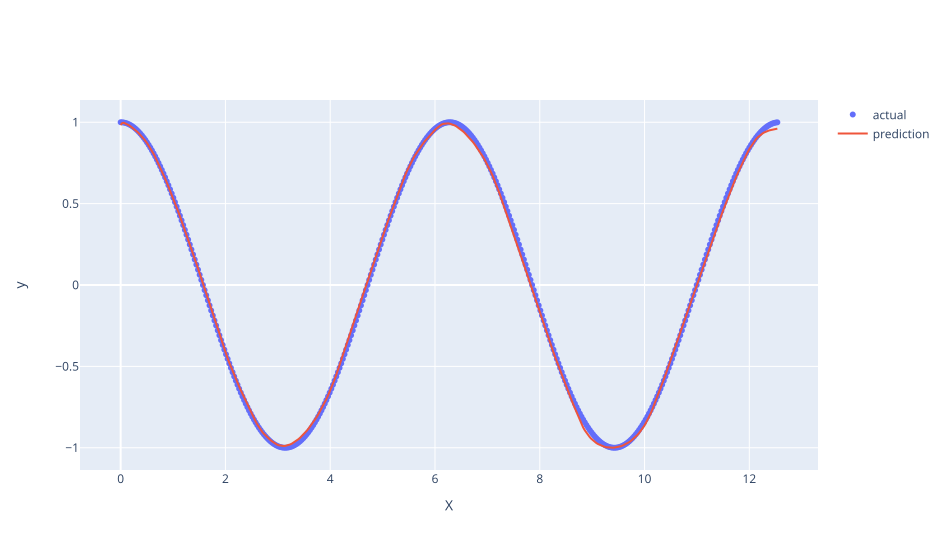

In [12]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=X.T[0],y=y.T[0], mode='markers', name='actual'))
fig.add_trace(go.Scatter(x=X.T[0], y=y_preds.T[0], mode='lines', name='prediction'))
fig.update_xaxes(title='X')
fig.update_yaxes(title='y')
fig.update_layout(template='plotly',width=950, height=550)
fig.show('svg')

# Classification<a id='class'><a>

In [19]:
class Classification(nn.Module):
    def __init__(self, sizes, dropout=None, act_fn='elu', output_act_fn='linear', batchnorm=False, 
                 init='kaiming_uniform', seed=None):
        super().__init__()
        if seed is not None:
            torch.manual_seed(seed)
        activation = {'relu':nn.ReLU(), 'lrelu':nn.LeakyReLU(), 'elu':nn.ELU(), 'linear':nn.Identity(),
                      'sigmoid':nn.Sigmoid(), 'softmax':nn.Softmax(dim=-1)}
        weight_init = {'kaiming_uniform':nn.init.kaiming_uniform_, 'kaiming_normal':nn.init.kaiming_normal_}
        self.sizes = sizes
        if dropout is None:
            p = np.zeros(len(sizes)-2)
        else:
            p = dropout
        layers = []
        for i in range(len(sizes)-1):
            if i==len(sizes)-2:
                layers.append(nn.Linear(sizes[i], sizes[i+1]))
                layers.append(activation[output_act_fn])
            else:
                if batchnorm:
                    layers.append(nn.Linear(sizes[i], sizes[i+1]))
                    layers.append(nn.BatchNorm1d(sizes[i+1]))
                    layers.append(activation[act_fn])
                    layers.append(nn.Dropout(p[i]))
                else:
                    layers.append(nn.Linear(sizes[i], sizes[i+1]))
                    layers.append(activation[act_fn])
                    layers.append(nn.Dropout(p[i]))
        self.model = nn.Sequential(*layers)
        if batchnorm:
            for i in range(0,len(layers)-1,4):
                weight_init[init](self.model[i].weight)
        else:
            for i in range(0,len(layers)-1,3):
                weight_init[init](self.model[i].weight)
            
            
    def forward(self, x):
        return self.model(x)
            
    def fit(self, epochs, dataloader_train, optimizer, scheduler, loss_fn, valid_metric, dataloader_validation=None, early_stop=10):
        best = 0
        count = 0
        if dataloader_validation is None:
            pp = ProgressPlot(plot_names=['Cross Entropy Loss vs Epoch', 'Accuracy vs Epoch'],line_names=['Train'])
        else:
            pp = ProgressPlot(plot_names=['Cross Entropy Loss vs Epoch', 'Accuracy vs Epoch'],line_names=['Train','Validation'])
        for epoch in range(epochs):
            self.train()
            train_loss = 0
            valid_loss = 0
            train_acc = 0
            valid_acc = 0
            for X_batch, y_batch in dataloader_train:
                optimizer.zero_grad()
                outputs = self(X_batch)
                loss = loss_fn(outputs, y_batch)
                loss.backward()
                train_loss += loss.item()*X_batch.shape[0]
                optimizer.step()
                metric = valid_metric(outputs, y_batch)
                train_acc += metric.item()*X_batch.shape[0]
            train_loss /= len(dataloader_train.dataset)
            train_acc /= len(dataloader_train.dataset)
            if dataloader_validation is None:
                pp.update([[train_loss], [train_acc]])
            else:
                for X_valid, y_valid in dataloader_validation:
                    pred = self.predict(X_valid)
                    loss = loss_fn(pred, y_valid)
                    valid_loss += loss.item()*X_valid.shape[0]
                    metric = valid_metric(pred, y_valid)
                    valid_acc += metric.item()*X_valid.shape[0]
                valid_loss /= len(dataloader_validation.dataset)
                valid_acc /= len(dataloader_validation.dataset)
                if valid_acc >= best:
                    best = valid_acc
                    count = 0
                else:
                    count += 1
                pp.update([[train_loss,valid_loss],[train_acc,valid_acc]])
                scheduler.step(train_loss)
            if count==early_stop:
                break
        pp.finalize()
        print(f'Train Loss: {train_loss}, Train Accuracy: {train_acc}')
        if dataloader_validation is not None:
            print(f'Valid Loss: {valid_loss}, Validation Accuracy: {valid_acc}')

    
    def trial_fit(self, trial, epochs, dataloader_train, optimizer, scheduler, loss_fn, valid_metric, dataloader_validation):
        pp = ProgressPlot(plot_names=['Cross Entropy Loss vs Epoch', 'Accuracy vs Epoch'],line_names=['Train','Validation'])
        for epoch in range(epochs):
            self.train()
            train_loss = 0
            valid_loss = 0
            train_acc = 0
            valid_acc = 0
            for X_batch, y_batch in dataloader_train:
                optimizer.zero_grad()
                outputs = self(X_batch)
                loss = loss_fn(outputs, y_batch)
                loss.backward()
                train_loss += loss.item()*X_batch.shape[0]
                optimizer.step()
                metric = valid_metric(outputs.softmax(dim=-1), y_batch)
                train_acc += metric.item()*X_batch.shape[0]

            for X_valid, y_valid in dataloader_validation:
                pred = self.predict(X_valid)
                loss = loss_fn(pred, y_valid)
                valid_loss += loss.item()*X_valid.shape[0]
                metric = valid_metric(pred.softmax(dim=-1), y_valid)
                valid_acc += metric.item()*X_valid.shape[0]
            
            train_loss /= len(dataloader_train.dataset)
            valid_loss /= len(dataloader_validation.dataset)
            train_acc /= len(dataloader_train.dataset)
            valid_acc /= len(dataloader_validation.dataset)
            pp.update([[train_loss, valid_loss],[train_acc, valid_acc]])
            scheduler.step(train_loss)
            trial.report(valid_acc, epoch)
            # Handle pruning based on the intermediate value.
            if trial.should_prune():
                raise optuna.exceptions.TrialPruned()
        
        pp.finalize()

        return valid_acc
    
    def predict(self, x):
        self.eval()
        with torch.inference_mode():
            pred = self(x)
        return pred

In [2]:
device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

Using mps device


In [3]:
train_valid = pd.read_csv('https://pjreddie.com/media/files/mnist_train.csv', header=None)

In [4]:
test = pd.read_csv('https://pjreddie.com/media/files/mnist_test.csv', header=None)

In [16]:
train_valid.head()

,0,1,2,3,4,5,6,7,8,9,...,775,776,777,778,779,780,781,782,783,784
0,5,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [17]:
test.head()

,0,1,2,3,4,5,6,7,8,9,...,775,776,777,778,779,780,781,782,783,784
0,7,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [18]:
train_valid.shape, test.shape

((60000, 785), (10000, 785))

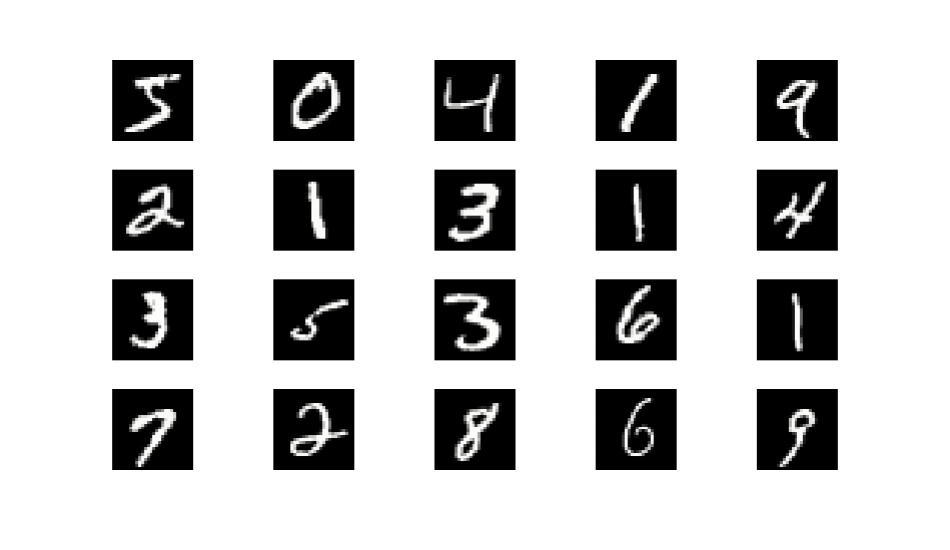

In [6]:
img = train_valid.iloc[0:20,1:].to_numpy().reshape(20,28,28)
fig = px.imshow(img, facet_col=0, color_continuous_scale='gray', facet_col_wrap=5)
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.update_layout(coloraxis_showscale=False,width=950, height=550)
for a in fig.layout.annotations:
    a.text = ''
fig.show('svg')

In [8]:
X_train = torch.tensor(train_valid.iloc[:50000, 1:].to_numpy(), device=device, dtype=torch.float32)
y_train = F.one_hot(torch.tensor(train_valid.iloc[:50000, 0].to_numpy(), device=device), num_classes=10).float()
X_valid = torch.tensor(train_valid.iloc[50000:, 1:].to_numpy(), device=device, dtype=torch.float32)
y_valid = F.one_hot(torch.tensor(train_valid.iloc[50000:, 0].to_numpy(), device=device), num_classes=10).float()
X_test = torch.tensor(test.iloc[:, 1:].to_numpy(), device=device, dtype=torch.float32)
y_test = F.one_hot(torch.tensor(test.iloc[:, 0].to_numpy(), device=device), num_classes=10).float()

In [9]:
dataset_train = TensorDataset(X_train ,y_train)
dataloader_train = DataLoader(dataset_train, batch_size=10, shuffle=True)
dataset_validation = TensorDataset(X_valid ,y_valid)
dataloader_validation = DataLoader(dataset_validation, batch_size=100, shuffle=False)

In [15]:
cls_model = Classification(sizes=[784,300,100,30,10],act_fn='elu',output_act_fn='linear',init='kaiming_normal', seed=0).to(device)
cls_model

Classification(
  (model): Sequential(
    (0): Linear(in_features=784, out_features=300, bias=True)
    (1): ELU(alpha=1.0)
    (2): Dropout(p=0.0, inplace=False)
    (3): Linear(in_features=300, out_features=100, bias=True)
    (4): ELU(alpha=1.0)
    (5): Dropout(p=0.0, inplace=False)
    (6): Linear(in_features=100, out_features=30, bias=True)
    (7): ELU(alpha=1.0)
    (8): Dropout(p=0.0, inplace=False)
    (9): Linear(in_features=30, out_features=10, bias=True)
    (10): Identity()
  )
)

In [16]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(cls_model.parameters(), lr=0.0001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3)

In [5]:
def acc_fn(y_pred, y):
    accuracy = Accuracy(task="multiclass", num_classes=10).to(device)
    return accuracy(y_pred.argmax(dim=1), y.argmax(dim=1))

In [17]:
cls_model.fit(epochs=30, dataloader_train=dataloader_train, dataloader_validation=dataloader_validation,
              optimizer=optimizer, scheduler=scheduler, loss_fn=criterion, valid_metric=acc_fn,early_stop=10)

Train Loss: 0.023350978730722106, Train Accuracy: 0.9944799987673759
Valid Loss: 0.24741491303924704, Validation Accuracy: 0.9716000086069108


In [18]:
y_preds = cls_model.predict(X_test)
print(f'Test Accuracy: {acc_fn(y_preds, y_test).item()}')

Test Accuracy: 0.9700999855995178


In [20]:
def objective(trial):
    
    # Prepare data
    dataset_train = TensorDataset(X_train ,y_train)
    batch_size = trial.suggest_int('batch', 10, 100)
    dataloader_train = DataLoader(dataset_train, batch_size=batch_size, shuffle=True)
    dataset_validation = TensorDataset(X_valid ,y_valid)
    dataloader_validation = DataLoader(dataset_validation, batch_size=batch_size, shuffle=False)
    
    # Generate network 
    n_layers = trial.suggest_int("n_layers", 2, 5)
    layers = []
    dropout = []
    in_features = 28 * 28
    final_class = 10
    layers.append(in_features)
    for i in range(n_layers):
        n_units= trial.suggest_int("n_units_l{}".format(i), 10, 500)
        layers.append(n_units)
        p = trial.suggest_float("dropout_l{}".format(i), 0., 0.5)
        dropout.append(p)
    layers.append(final_class)
    
    act_fn = trial.suggest_categorical("act_fn", ["elu", "lrelu", "relu"])
    init = trial.suggest_categorical("init", ['kaiming_normal', 'kaiming_uniform'])
    batchnorm = trial.suggest_categorical("batchnorm", [True, False])
    # Generate the model.
    model = Classification(sizes=layers, dropout=dropout, batchnorm=batchnorm, act_fn=act_fn, output_act_fn='linear',
                           init=init, seed=0).to(device)

    # Generate the optimizers.
    optimizer_name = trial.suggest_categorical("optimizer", ["Adam", "RMSprop", "SGD"])
    lr = trial.suggest_float("lr", 1e-6, 1e-3, log=True)
    weight_decay = trial.suggest_float("Reg", 1e-6, 1e-1, log=True)
    optimizer = getattr(optim, optimizer_name)(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)
    
    # Loss
    criterion = nn.CrossEntropyLoss()
    
    # Train & Validate
    return model.trial_fit(trial, epochs=30, dataloader_train=dataloader_train, optimizer=optimizer, 
                           scheduler=scheduler,loss_fn=criterion, valid_metric=acc_fn, dataloader_validation=dataloader_validation)
    


In [21]:
sampler = optuna.samplers.TPESampler(seed=0)
study = optuna.create_study(direction="maximize", sampler=sampler, pruner=optuna.pruners.HyperbandPruner())
study.optimize(objective, n_trials=50)

[I 2024-04-27 02:46:25,255] A new study created in memory with name: no-name-9163d92b-1c2a-4bc4-ab6d-94a49e0a5bfc


[I 2024-04-27 02:49:47,127] Trial 0 finished with value: 0.9233999960124493 and parameters: {'batch': 59, 'n_layers': 4, 'n_units_l0': 305, 'dropout_l0': 0.27244159149844843, 'n_units_l1': 218, 'dropout_l1': 0.32294705653332806, 'n_units_l2': 224, 'dropout_l2': 0.4458865003910399, 'n_units_l3': 483, 'dropout_l3': 0.19172075941288885, 'act_fn': 'elu', 'init': 'kaiming_normal', 'batchnorm': True, 'optimizer': 'SGD', 'lr': 0.0008626905220714901, 'Reg': 0.009903593841281122}. Best is trial 0 with value: 0.9233999960124493.


[I 2024-04-27 02:57:02,038] Trial 1 finished with value: 0.9698000018000603 and parameters: {'batch': 51, 'n_layers': 5, 'n_units_l0': 68, 'dropout_l0': 0.3199605106637619, 'n_units_l1': 80, 'dropout_l1': 0.47233445852479194, 'n_units_l2': 266, 'dropout_l2': 0.2073309699952618, 'n_units_l3': 139, 'dropout_l3': 0.38711684471710833, 'n_units_l4': 233, 'dropout_l4': 0.28421697443432425, 'act_fn': 'lrelu', 'init': 'kaiming_uniform', 'batchnorm': True, 'optimizer': 'RMSprop', 'lr': 0.00010006913513545568, 'Reg': 0.00225522225239458}. Best is trial 1 with value: 0.9698000018000603.


<IPython.core.display.Javascript object>

[I 2024-04-27 02:57:44,527] Trial 2 pruned. 


[I 2024-04-27 03:02:49,265] Trial 3 finished with value: 0.9198000053167343 and parameters: {'batch': 27, 'n_layers': 3, 'n_units_l0': 413, 'dropout_l0': 0.048550637896530635, 'n_units_l1': 421, 'dropout_l1': 0.048049203946981534, 'n_units_l2': 489, 'dropout_l2': 0.2343256008238508, 'act_fn': 'elu', 'init': 'kaiming_uniform', 'batchnorm': False, 'optimizer': 'SGD', 'lr': 1.5575517641504765e-06, 'Reg': 0.002899750265370693}. Best is trial 1 with value: 0.9698000018000603.


<IPython.core.display.Javascript object>

[I 2024-04-27 03:05:35,224] Trial 4 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:05:57,732] Trial 5 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:07:35,541] Trial 6 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:08:24,901] Trial 7 pruned. 


[I 2024-04-27 03:11:44,496] Trial 8 finished with value: 0.9770000082373619 and parameters: {'batch': 57, 'n_layers': 2, 'n_units_l0': 108, 'dropout_l0': 0.009260897230306986, 'n_units_l1': 399, 'dropout_l1': 0.11196234403019006, 'act_fn': 'lrelu', 'init': 'kaiming_uniform', 'batchnorm': True, 'optimizer': 'RMSprop', 'lr': 4.044812636651486e-05, 'Reg': 0.0008903276925292269}. Best is trial 8 with value: 0.9770000082373619.


[I 2024-04-27 03:14:54,338] Trial 9 finished with value: 0.9809999913930892 and parameters: {'batch': 76, 'n_layers': 3, 'n_units_l0': 205, 'dropout_l0': 0.10492187448756107, 'n_units_l1': 101, 'dropout_l1': 0.4721861949919668, 'n_units_l2': 373, 'dropout_l2': 0.24522940430878354, 'act_fn': 'lrelu', 'init': 'kaiming_normal', 'batchnorm': True, 'optimizer': 'Adam', 'lr': 0.00010918885718097317, 'Reg': 0.0001855599397268542}. Best is trial 9 with value: 0.9809999913930892.


<IPython.core.display.Javascript object>

[I 2024-04-27 03:15:04,378] Trial 10 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:15:24,788] Trial 11 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:15:36,729] Trial 12 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:19:51,908] Trial 13 pruned. 


[I 2024-04-27 03:22:46,948] Trial 14 finished with value: 0.9820999921441078 and parameters: {'batch': 73, 'n_layers': 2, 'n_units_l0': 107, 'dropout_l0': 0.10986217464895304, 'n_units_l1': 365, 'dropout_l1': 0.3542732281985148, 'act_fn': 'lrelu', 'init': 'kaiming_uniform', 'batchnorm': True, 'optimizer': 'Adam', 'lr': 0.000522029319925036, 'Reg': 0.00042417338941939985}. Best is trial 14 with value: 0.9820999921441078.


[I 2024-04-27 03:26:23,613] Trial 15 finished with value: 0.9827999938488007 and parameters: {'batch': 77, 'n_layers': 4, 'n_units_l0': 208, 'dropout_l0': 0.20817399826528435, 'n_units_l1': 167, 'dropout_l1': 0.38599311451175067, 'n_units_l2': 350, 'dropout_l2': 0.07477291944037479, 'n_units_l3': 254, 'dropout_l3': 0.001505787708449724, 'act_fn': 'relu', 'init': 'kaiming_normal', 'batchnorm': True, 'optimizer': 'Adam', 'lr': 0.0008123389160745878, 'Reg': 1.340512682925532e-06}. Best is trial 15 with value: 0.9827999938488007.


[I 2024-04-27 03:29:31,248] Trial 16 finished with value: 0.9839999990463257 and parameters: {'batch': 97, 'n_layers': 4, 'n_units_l0': 239, 'dropout_l0': 0.21909760913511717, 'n_units_l1': 187, 'dropout_l1': 0.3744899303621525, 'n_units_l2': 340, 'dropout_l2': 0.027751322778192034, 'n_units_l3': 258, 'dropout_l3': 0.050657043103749445, 'act_fn': 'relu', 'init': 'kaiming_normal', 'batchnorm': True, 'optimizer': 'Adam', 'lr': 0.000822225163908364, 'Reg': 1.024431127953269e-06}. Best is trial 16 with value: 0.9839999990463257.


[I 2024-04-27 03:32:35,434] Trial 17 finished with value: 0.9825999971210957 and parameters: {'batch': 99, 'n_layers': 4, 'n_units_l0': 226, 'dropout_l0': 0.37185102583096374, 'n_units_l1': 184, 'dropout_l1': 0.3915788791176682, 'n_units_l2': 343, 'dropout_l2': 0.04527299579366131, 'n_units_l3': 253, 'dropout_l3': 0.0012151632510776762, 'act_fn': 'relu', 'init': 'kaiming_normal', 'batchnorm': True, 'optimizer': 'Adam', 'lr': 0.0004270719080603783, 'Reg': 2.487529886850974e-06}. Best is trial 16 with value: 0.9839999990463257.


[I 2024-04-27 03:36:00,627] Trial 18 finished with value: 0.9830999897241592 and parameters: {'batch': 87, 'n_layers': 4, 'n_units_l0': 252, 'dropout_l0': 0.2240026290456848, 'n_units_l1': 237, 'dropout_l1': 0.2882963193830284, 'n_units_l2': 303, 'dropout_l2': 0.10781951712065552, 'n_units_l3': 246, 'dropout_l3': 0.009324260971598525, 'act_fn': 'relu', 'init': 'kaiming_normal', 'batchnorm': True, 'optimizer': 'Adam', 'lr': 0.0008409647764532895, 'Reg': 2.073726706923735e-05}. Best is trial 16 with value: 0.9839999990463257.


<IPython.core.display.Javascript object>

[I 2024-04-27 03:37:24,783] Trial 19 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:38:34,555] Trial 20 pruned. 


[I 2024-04-27 03:42:02,356] Trial 21 finished with value: 0.9846000009179116 and parameters: {'batch': 85, 'n_layers': 4, 'n_units_l0': 225, 'dropout_l0': 0.2204040411891338, 'n_units_l1': 171, 'dropout_l1': 0.39546340667531055, 'n_units_l2': 322, 'dropout_l2': 0.00793693887155035, 'n_units_l3': 319, 'dropout_l3': 0.0017485591084280489, 'act_fn': 'relu', 'init': 'kaiming_normal', 'batchnorm': True, 'optimizer': 'Adam', 'lr': 0.0007844287374996624, 'Reg': 1.4060798980967076e-06}. Best is trial 21 with value: 0.9846000009179116.


<IPython.core.display.Javascript object>

[I 2024-04-27 03:45:08,515] Trial 22 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:45:51,844] Trial 23 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:46:17,115] Trial 24 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:46:28,701] Trial 25 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:48:40,435] Trial 26 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:48:55,731] Trial 27 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:49:18,830] Trial 28 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:49:38,963] Trial 29 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:51:00,802] Trial 30 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:51:32,315] Trial 31 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:53:01,234] Trial 32 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:53:20,118] Trial 33 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:53:48,995] Trial 34 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:56:03,545] Trial 35 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:56:17,123] Trial 36 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 03:59:24,995] Trial 37 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:00:24,511] Trial 38 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:00:48,408] Trial 39 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:01:51,444] Trial 40 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:02:18,539] Trial 41 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:03:21,788] Trial 42 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:03:50,528] Trial 43 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:04:14,005] Trial 44 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:04:27,740] Trial 45 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:04:56,646] Trial 46 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:05:53,298] Trial 47 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:06:23,024] Trial 48 pruned. 


<IPython.core.display.Javascript object>

[I 2024-04-27 04:06:48,257] Trial 49 pruned. 


In [22]:
best_trial = study.best_trial
best_params = best_trial.params

In [239]:
best_params

{'batch': 38,
 'n_layers': 3,
 'n_units_l0': 453,
 'dropout_l0': 0.3975411612650765,
 'n_units_l1': 297,
 'dropout_l1': 0.4259353084311372,
 'n_units_l2': 500,
 'dropout_l2': 0.22851292765077946,
 'act_fn': 'relu',
 'init': 'kaiming_uniform',
 'batchnorm': True,
 'optimizer': 'RMSprop',
 'lr': 0.00017836658873196778,
 'Reg': 0.00036022452864081377}

In [23]:
dataloader_train = DataLoader(dataset_train, batch_size=best_params['batch'], shuffle=True)
dataloader_validation = DataLoader(dataset_validation, batch_size=best_params['batch'], shuffle=False)

# Generate network 
layers = [28*28, 453, 297, 500, 10]
dropout = [0.3975411612650765, 0.4259353084311372, 0.22851292765077946]

# Generate the model.
model = Classification(sizes=layers, dropout=dropout, batchnorm=True, act_fn='relu', output_act_fn='linear',
                           init='kaiming_uniform', seed=0).to(device)

# Generate the optimizers.
optimizer_name = 'RMSprop'
optimizer = getattr(optim, optimizer_name)(model.parameters(), lr=best_params['lr'], weight_decay=best_params['Reg'])
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)
    
# Loss
criterion = nn.CrossEntropyLoss()
    
# Train & Validate
model.fit(epochs=30, dataloader_train=dataloader_train, optimizer=optimizer, scheduler=scheduler,
          loss_fn=criterion, valid_metric=acc_fn, dataloader_validation=dataloader_validation)

Train Loss: 0.034880149710392286, Train Accuracy: 0.9886400006771088
Valid Loss: 0.073749567166813, Validation Accuracy: 0.984300000935793


In [24]:
y_preds = model.predict(X_test)
print(f'Test Accuracy: {acc_fn(y_preds, y_test).item()}')

Test Accuracy: 0.9840999841690063


# Image Classification<a id='imc'><a>

In [8]:
class ImageClassification(nn.Module):
    def __init__(self, sizes, dropout=None, act_fn='elu', output_act_fn='linear', batchnorm=False, 
                 init='kaiming_uniform', seed=None):
        super().__init__()
        if seed is not None:
            torch.manual_seed(seed)
        activation = {'relu':nn.ReLU(), 'lrelu':nn.LeakyReLU(), 'elu':nn.ELU(), 'linear':nn.Identity(),
                      'sigmoid':nn.Sigmoid(), 'softmax':nn.Softmax(dim=-1)}
        weight_init = {'kaiming_uniform':nn.init.kaiming_uniform_, 'kaiming_normal':nn.init.kaiming_normal_}
        self.sizes = sizes
        if dropout is None:
            p = np.zeros(len(sizes)-2)
        else:
            p = dropout
        self.feature_extractor = nn.Sequential(
            nn.Conv2d(1, 32, kernel_size=3, padding = 1),
            activation[act_fn],
            nn.MaxPool2d(kernel_size=2),
            nn.Conv2d(32, 64, kernel_size=3, padding = 1),
            activation[act_fn],
            nn.MaxPool2d(kernel_size=2),
            nn.Flatten()
        )
        layers = []
        for i in range(len(sizes)-1):
            if i==len(sizes)-2:
                layers.append(nn.Linear(sizes[i], sizes[i+1]))
                layers.append(activation[output_act_fn])
            else:
                if batchnorm:
                    layers.append(nn.Linear(sizes[i], sizes[i+1]))
                    layers.append(nn.BatchNorm1d(sizes[i+1]))
                    layers.append(activation[act_fn])
                    layers.append(nn.Dropout(p[i]))
                else:
                    layers.append(nn.Linear(sizes[i], sizes[i+1]))
                    layers.append(activation[act_fn])
                    layers.append(nn.Dropout(p[i]))
        self.model = nn.Sequential(*layers)
        if batchnorm:
            for i in range(0,len(layers)-1,4):
                weight_init[init](self.model[i].weight)
        else:
            for i in range(0,len(layers)-1,3):
                weight_init[init](self.model[i].weight)
            
            
    def forward(self, x):
        return self.model(self.feature_extractor(x))
            
    def fit(self, epochs, dataloader_train, optimizer, scheduler, loss_fn, valid_metric, dataloader_validation=None, early_stop=10):
        best = 0
        count = 0
        if dataloader_validation is None:
            pp = ProgressPlot(plot_names=['Cross Entropy Loss vs Epoch', 'Accuracy vs Epoch'],line_names=['Train'])
        else:
            pp = ProgressPlot(plot_names=['Cross Entropy Loss vs Epoch', 'Accuracy vs Epoch'],line_names=['Train','Validation'])
        for epoch in range(epochs):
            self.train()
            train_loss = 0
            valid_loss = 0
            train_acc = 0
            valid_acc = 0
            for X_batch, y_batch in dataloader_train:
                optimizer.zero_grad()
                outputs = self(X_batch)
                loss = loss_fn(outputs, y_batch)
                loss.backward()
                train_loss += loss.item()*X_batch.shape[0]
                optimizer.step()
                metric = valid_metric(outputs, y_batch)
                train_acc += metric.item()*X_batch.shape[0]
            train_loss /= len(dataloader_train.dataset)
            train_acc /= len(dataloader_train.dataset)
            if dataloader_validation is None:
                pp.update([[train_loss], [train_acc]])
            else:
                for X_valid, y_valid in dataloader_validation:
                    pred = self.predict(X_valid)
                    loss = loss_fn(pred, y_valid)
                    valid_loss += loss.item()*X_valid.shape[0]
                    metric = valid_metric(pred, y_valid)
                    valid_acc += metric.item()*X_valid.shape[0]
                valid_loss /= len(dataloader_validation.dataset)
                valid_acc /= len(dataloader_validation.dataset)
                if valid_acc >= best:
                    best = valid_acc
                    count = 0
                else:
                    count += 1
                pp.update([[train_loss,valid_loss],[train_acc,valid_acc]])
                scheduler.step(train_loss)
            if count==early_stop:
                break
        pp.finalize()
        print(f'Train Loss: {train_loss}, Train Accuracy: {train_acc}')
        if dataloader_validation is not None:
            print(f'Valid Loss: {valid_loss}, Validation Accuracy: {valid_acc}')

    
    def trial_fit(self, trial, epochs, dataloader_train, optimizer, scheduler, loss_fn, valid_metric, dataloader_validation):
        pp = ProgressPlot(plot_names=['Cross Entropy Loss vs Epoch', 'Accuracy vs Epoch'],line_names=['Train','Validation'])
        for epoch in range(epochs):
            self.train()
            train_loss = 0
            valid_loss = 0
            train_acc = 0
            valid_acc = 0
            for X_batch, y_batch in dataloader_train:
                optimizer.zero_grad()
                outputs = self(X_batch)
                loss = loss_fn(outputs, y_batch)
                loss.backward()
                train_loss += loss.item()*X_batch.shape[0]
                optimizer.step()
                metric = valid_metric(outputs, y_batch)
                train_acc += metric.item()*X_batch.shape[0]

            for X_valid, y_valid in dataloader_validation:
                pred = self.predict(X_valid)
                loss = loss_fn(pred, y_valid)
                valid_loss += loss.item()*X_valid.shape[0]
                metric = valid_metric(pred, y_valid)
                valid_acc += metric.item()*X_valid.shape[0]
            
            train_loss /= len(dataloader_train.dataset)
            valid_loss /= len(dataloader_validation.dataset)
            train_acc /= len(dataloader_train.dataset)
            valid_acc /= len(dataloader_validation.dataset)
            pp.update([[train_loss, valid_loss],[train_acc, valid_acc]])
            scheduler.step(train_loss)
            trial.report(valid_acc, epoch)
            # Handle pruning based on the intermediate value.
            if trial.should_prune():
                raise optuna.exceptions.TrialPruned()
        
        pp.finalize()

        return valid_acc
    
    def predict(self, x):
        self.eval()
        with torch.inference_mode():
            pred = self(x)
        return pred

In [6]:
X_train = torch.tensor(train_valid.iloc[:50000, 1:].to_numpy(), device=device, dtype=torch.float32).view(-1, 1, 28, 28)
y_train = F.one_hot(torch.tensor(train_valid.iloc[:50000, 0].to_numpy(), device=device), num_classes=10).float()
X_valid = torch.tensor(train_valid.iloc[50000:, 1:].to_numpy(), device=device, dtype=torch.float32).view(-1, 1, 28, 28)
y_valid = F.one_hot(torch.tensor(train_valid.iloc[50000:, 0].to_numpy(), device=device), num_classes=10).float()
X_test = torch.tensor(test.iloc[:, 1:].to_numpy(), device=device, dtype=torch.float32).view(-1, 1, 28, 28)
y_test = F.one_hot(torch.tensor(test.iloc[:, 0].to_numpy(), device=device), num_classes=10).float()

In [7]:
dataset_train = TensorDataset(X_train ,y_train)
dataloader_train = DataLoader(dataset_train, batch_size=10, shuffle=True)
dataset_validation = TensorDataset(X_valid ,y_valid)
dataloader_validation = DataLoader(dataset_validation, batch_size=10, shuffle=False)

In [22]:
img_model = ImageClassification(sizes=[64*49,300,10],act_fn='elu',output_act_fn='linear',init='kaiming_normal', seed=0).to(device)
img_model

ImageClassification(
  (feature_extractor): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ELU(alpha=1.0)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ELU(alpha=1.0)
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Flatten(start_dim=1, end_dim=-1)
  )
  (model): Sequential(
    (0): Linear(in_features=3136, out_features=300, bias=True)
    (1): ELU(alpha=1.0)
    (2): Dropout(p=0.0, inplace=False)
    (3): Linear(in_features=300, out_features=10, bias=True)
    (4): Identity()
  )
)

In [23]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(img_model.parameters(), lr=0.0001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3)

In [24]:
img_model.fit(epochs=50, dataloader_train=dataloader_train, dataloader_validation=dataloader_validation,
optimizer=optimizer, scheduler=scheduler, loss_fn=criterion, valid_metric=acc_fn,early_stop=10)

Train Loss: 1.4305113893442466e-11, Train Accuracy: 1.0
Valid Loss: 0.12883526232081036, Validation Accuracy: 0.9908999980688095


In [25]:
y_preds = img_model.predict(X_test)
print(f'Test Accuracy: {acc_fn(y_preds, y_test).item()}')

Test Accuracy: 0.9927999973297119


# Data Augmentation<a id='augment'><a>

In [9]:
transforms = v2.Compose([v2.RandomRotation(15), v2.RandomAffine(degrees=0, translate=(0.05,0.05))])
out = transforms(X_train[0:20].view(20, 28, 28))

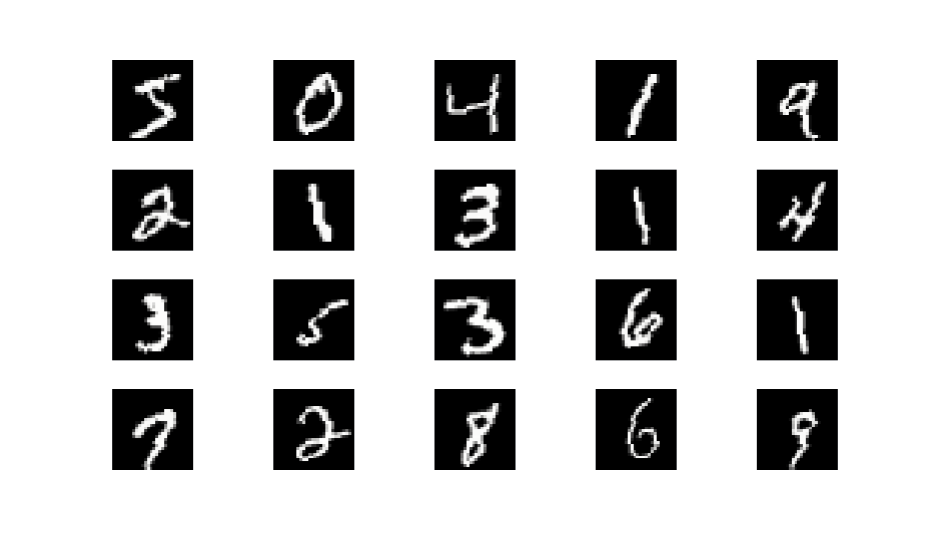

In [66]:
fig = px.imshow(out.cpu().numpy(), facet_col=0, color_continuous_scale='gray', facet_col_wrap=5)
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.update_layout(coloraxis_showscale=False,width=950, height=550)
for a in fig.layout.annotations:
    a.text = ''
fig.show('svg')

In [10]:
class ImageDataset(Dataset):
    def __init__(self, X, y, transform=None):
        super().__init__()
        if transform:
            augment = transform(X)
            self.image = torch.cat([X, augment],dim=0)
            self.label = torch.vstack([y, y])
        else:
            self.image = X
            self.label = y

    def __len__(self):
        return self.image.shape[0]
    
    def __getitem__(self, idx):

        image = self.image[idx]
        label = self.label[idx]
            
        return image, label

In [11]:
dataset_train_augmented = ImageDataset(X_train ,y_train, transforms)
dataloader_train_augmented = DataLoader(dataset_train_augmented, batch_size=10, shuffle=True)

In [12]:
img_model_aug = ImageClassification(sizes=[64*49,300,10],act_fn='elu',output_act_fn='linear',init='kaiming_normal', seed=0).to(device)
img_model_aug

ImageClassification(
  (feature_extractor): Sequential(
    (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ELU(alpha=1.0)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ELU(alpha=1.0)
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Flatten(start_dim=1, end_dim=-1)
  )
  (model): Sequential(
    (0): Linear(in_features=3136, out_features=300, bias=True)
    (1): ELU(alpha=1.0)
    (2): Dropout(p=0.0, inplace=False)
    (3): Linear(in_features=300, out_features=10, bias=True)
    (4): Identity()
  )
)

In [13]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(img_model_aug.parameters(), lr=0.0001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3)

In [14]:
img_model_aug.fit(epochs=50, dataloader_train=dataloader_train_augmented, dataloader_validation=dataloader_validation,
optimizer=optimizer, scheduler=scheduler, loss_fn=criterion, valid_metric=acc_fn,early_stop=10)

Train Loss: 2.7418134784795713e-11, Train Accuracy: 1.0
Valid Loss: 0.11570539501103123, Validation Accuracy: 0.9934999985098839


In [20]:
dataset_test = TensorDataset(X_test ,y_test)
dataloader_test = DataLoader(dataset_test, batch_size=10, shuffle=False)

In [22]:
test_acc = 0
for i, j in dataloader_test:
    pred = img_model_aug.predict(i)
    test_acc += acc_fn(pred, j).item()*j.shape[0]
print(f'Test Accuracy: {test_acc/X_test.shape[0]}')

Test Accuracy: 0.9916999981999397
